## Inference

Objective : get damage map at scale.

DRAFT : 
- to do :
    - refacto evaluation.ipynb funtions and classes into src
    - import utils above in this notebook

get th for fresnunet : 0.37

In [218]:
def pipeline_run_sample(
    th: float,
    model_name:str,
    sample: gpd.GeoSeries, 
    s_buffer: int,
    method: str,
    fill_holes: bool,
    resolution: int,
    building_buffer: int, 
    save:bool=False):

    def get_binary_dm(urban_zs_pred, th):
    
        urban_zs_pred_binary = urban_zs_pred.copy()
        urban_zs_pred_binary["sum"] = (urban_zs_pred_binary["sum"] > th)
        
        return urban_zs_pred_binary

    sample_pred = sample[["before_path_png", "after_path_png", "img_id"]].rename({"before_path_png":"before_path", "after_path_png":"after_path"})
    
    output = inference_on_sample(sample_pred, model_name=model_name)

    img_id, town_name, loc, b_rs_path, a_rs_path = sample[["img_id", "town_name", "geometry", "before_path", "after_path"]].values.squeeze()

    out_dir = check_dir(results_dir_path, model_name , "dm", "pred", img_id)

    rs_a = rioxr.open_rasterio(a_rs_path)

    urban_path = extract_urban_area(name=town_name,
                                  before_rs_path=b_rs_path, 
                                  loc=loc, 
                                  method_seg=method,
                                  fill_holes=fill_holes,
                                  resolution=resolution,
                                  building_buffer=building_buffer)

    #urb = gpd.read_file(urban_path) 

    urban_zs_pred = process_sample(output, urban_path, a_rs_path)

    urban_zs_pred_binary = get_binary_dm(urban_zs_pred, th)

    urban_zs_pred_binary["img_id"] = img_id
    urban_zs_pred_binary["town_name"] = town_name


    return urban_zs_pred_binary

In [219]:
def process_sample(output, urban_path, a_path):
    
    pred = processing_pred_eval(output)
    urban = gpd.read_file(urban_path)
    urban = (
        urban
        .drop_duplicates("geometry")
        .dropna(subset=["geometry"])
        .reset_index(drop=True)
    )

    viz_name = Path(urban_path).stem
    
    # change io operation path or remove files
    rs_pred_path = mask_array_to_geotiff(pred, rs_path_src=a_path, out_path="out_test_pred.tif")

    rs_pred = rioxr.open_rasterio(rs_pred_path)

    urban_zs_pred = get_raster_stats_on_poly(urban, rs_pred)

    return urban_zs_pred

In [291]:
import warnings
from sklearn.exceptions import UndefinedMetricWarning

warnings.filterwarnings('ignore')

s_buffer = 157
save= True
method = "osm_buffer"
fill_holes=True
resolution=12
building_buffer=7

results = []

model_name = "FresUNet"
version = "1"
th = 0.37

models_entry = init_models_entry()
models_entry[model_name]["path"] = MODELS_VERSION[model_name][version]

cnt=0

plt.ioff()

for i, row in tqdm(dataset.iterrows(), total=len(dataset)): 
    
    #if cnt == 1: break
    results.append(
        pipeline_run_sample(
            th=th,
            model_name=model_name,
            sample=row, 
            s_buffer=s_buffer,
            method=method,
            fill_holes=fill_holes,
            resolution=resolution,
            building_buffer=building_buffer, 
            save=save)
    )
    cnt+=1

100%|█████████████████████████████████████████████████| 183/183 [02:40<00:00,  1.14it/s]


In [221]:
results[0].head(1)

,id_hex,index,grid_resol,cell_area,geometry,max,mean,count,sum,median,majority,img_id,town_name
0,8c3983100d029ff,0,12,334.587455,"POLYGON ((545675.849 3454728.404, 545685.098 3...",0.527418,0.135585,3588,True,0.110412,0.132712,58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e,480


In [ ]:
#out_dir = check_dir(processed_dir_path, "dataset", "buildings")

#build = gpd.read_file(make_path("8855e718-c994-4141-92ad-6d876393d557", out_dir))

In [292]:
damage_map = pd.concat([df[["town_name","img_id","sum", "geometry"]].rename({"sum":"damage"}, axis=1) for df in results])

In [293]:
damage_map.to_file(make_path("damage_map_dataset.gpkg", result_dir.format(model_name)))

In [294]:
result_dir.format(model_name)

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/results/FresUNet/dm/labelled'

In [153]:
damage_town = damage_map.groupby("town_name")["damage"].value_counts().to_frame()

In [154]:
damage_town = damage_town.reset_index().pivot(index="town_name", columns=["damage"], values=["damage", "count"]).drop("damage", axis=1).fillna(0)

In [155]:
damage_town.columns = ["no_damage", "damage"]

In [156]:
damage_town["perc_damage"] = damage_town["damage"] / (damage_town["damage"] + damage_town["no_damage"])

<Axes: >

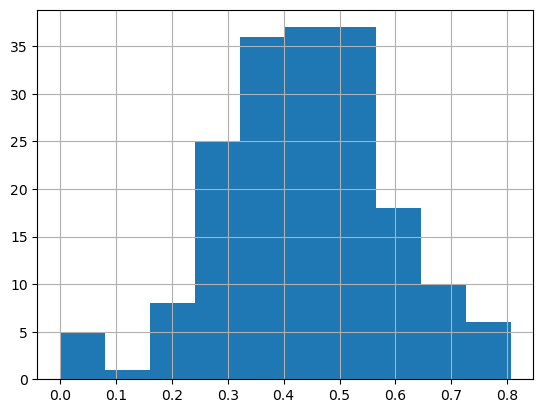

In [157]:
plt.ion()
damage_town["perc_damage"].hist()


Text(0.5, 0, 'level of damage (%)')

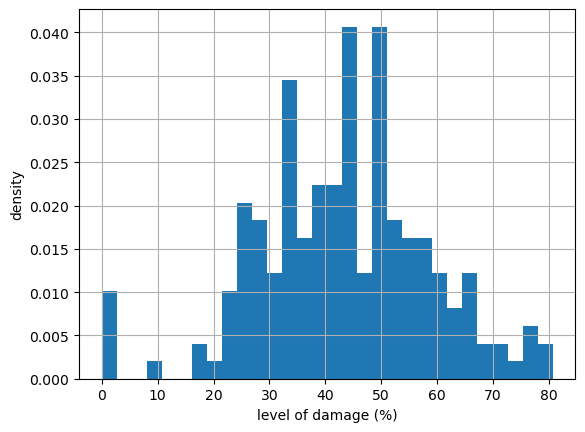

In [167]:
(damage_town["perc_damage"]*100).hist(bins=30, density=True)
plt.ylabel("density")
plt.xlabel("level of damage (%)")

<Axes: xlabel='town_name'>

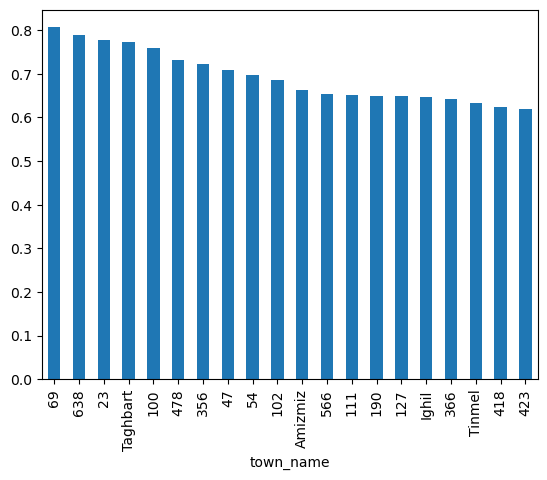

In [301]:
damage_town["perc_damage"].sort_values(ascending= False)[:20].plot(kind="bar")

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'Taghbart'),
  Text(1, 0, 'Amizmiz'),
  Text(2, 0, 'Ighil'),
  Text(3, 0, 'Tinmel'),
  Text(4, 0, 'Ouneine'),
  Text(5, 0, "Talat N'Yaaqoub"),
  Text(6, 0, 'Tijghicht'),
  Text(7, 0, "M'Zouda"),
  Text(8, 0, 'Ijoukak')])

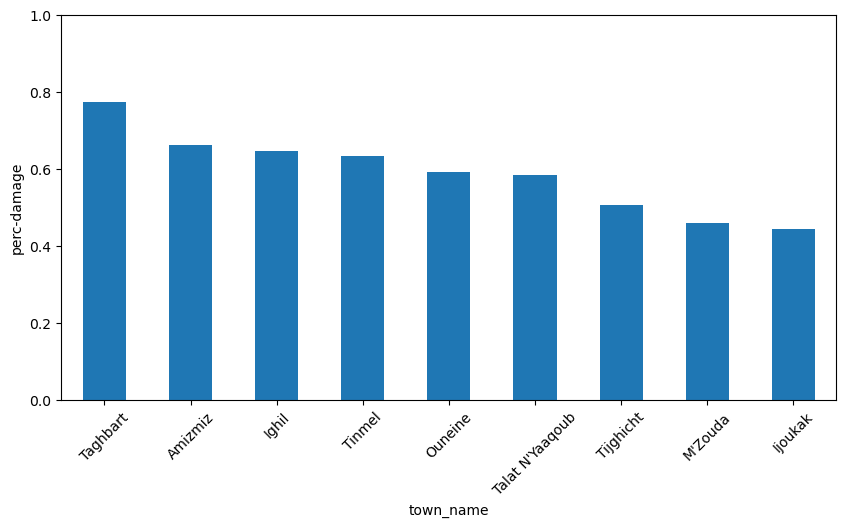

In [174]:
plt.figure(figsize=(10, 5))
damage_town_known = damage_town.reset_index()
damage_town_known[damage_town_known.town_name.apply(lambda x: len(x) > 3)].set_index("town_name")["perc_damage"].sort_values(ascending= False).plot(kind="bar")
plt.ylabel("perc-damage")
plt.ylim([0, 1])
plt.xticks(rotation=45)

Amizmiz = 31°13'18"N 8°14'32"W

In [ ]:
damage_town_known[damage_town_known.town_name.apply(lambda x: len(x) > 3)]

In [ ]:
damage_town[damage_town.town_name]

### Visualisation

In [ ]:
import folium
from folium import raster_layers
from shapely import Point 

def explore_dm(urban_zs_pred: gpd.GeoDataFrame, 
               img_id: int, 
               dataset: gpd.GeoDataFrame, 
              urban_zs_label: gpd.GeoDataFrame=None, 
):


    town_name, loc, b_rs_path, a_rs_path = dataset.loc[dataset.img_id == img_id, ["town_name", "geometry", "before_path", "after_path"]].values.squeeze()
    
    
    rs_b = rioxr.open_rasterio(b_rs_path)
    data_b = rs_b.data.transpose(1, 2, 0)
    rs_a = rioxr.open_rasterio(a_rs_path)
    data_a = rs_a.data.transpose(1, 2, 0)
    
    #geom_building = get_building_from_location(loc, s_buffer)
    #data = rs_b.data.transpose(1, 2, 0)
    
    bbox = gpd.GeoSeries(box(*rs_a.rio.bounds()), crs=CRS).to_crs(4326)
    min_lon, min_lat, max_lon, max_lat = bbox.bounds.values.squeeze()
    
    center = (bbox.centroid.squeeze().y, bbox.centroid.squeeze().x)
    
    # create the map
    map_ = folium.Map(location=center, zoom_start=17)
    
    urban_zs_pred.explore(m=map_, column="damage", name="dm_pred", cmap="RdBu_r", style_kwds=dict(fillOpacity=0.3, opacity=0.3, stroke=False))
    #folium.GeoJson(urban_zs_pred[["damage", "geometry"]], style_function=lambda x: {"color":"green", "opacity":0.3, "fillOpacity":0.1}, name="dm_pred").add_to(map_)

    
    # Overlay the image
    map_.add_child(raster_layers.ImageOverlay(data_a, 
                                              opacity=0.9,
                                              bounds =[[min_lat, min_lon], [max_lat, max_lon]], 
                                              name="rs_a")
                  )
    
    # Overlay the image
    map_.add_child(raster_layers.ImageOverlay(data_b, 
                                              opacity=0.9,
                                              bounds =[[min_lat, min_lon], [max_lat, max_lon]], 
                                              name="rs_b")
                  )
    
    
    folium.LayerControl().add_to(map_)
    
    return map_

In [139]:
gdf = load_maxar_items(type_item="visual")

In [149]:
talat_ds = dataset.loc[dataset.img_id == talat.img_id.unique()[0]]
talat_b_path = talat_ds.before_href.squeeze()
talat_a_path = talat_ds.after_href.squeeze()

In [151]:
gdf[gdf.href == talat_b_path]

,id,type,title,href,datetime,platform,gsd,catalog_id,utm_zone,quadkey,view_off_nadir,view_azimuth,view_incidence_angle,view_sun_azimuth,view_sun_elevation,proj_epsg,grid_code,data_area,clouds_area,clouds_percent,geometry_bbox,geometry,after_event
5686,29/120202021131/1040010077691A00,image/tiff; application=geotiff; profile=cloud...,Visual Image,https://maxar-opendata.s3.amazonaws.com/events...,2022-06-23 11:12:12Z,WV03,0.36,1040010077691A00,29,120202021131,24.200001,127.400002,63.3,106.8,70.2,32629,MXRA-Z29-120202021131,28.203125,0.0,0.0,"[574843.75, 3424843.75, 580156.25, 3430156.25]","POLYGON ((574843.750 3430156.250, 580156.250 3...",0


In [152]:
gdf[gdf.href == talat_a_path]

,id,type,title,href,datetime,platform,gsd,catalog_id,utm_zone,quadkey,view_off_nadir,view_azimuth,view_incidence_angle,view_sun_azimuth,view_sun_elevation,proj_epsg,grid_code,data_area,clouds_area,clouds_percent,geometry_bbox,geometry,after_event
2841,29/120202021131/10300500E4F92300,image/tiff; application=geotiff; profile=cloud...,Visual Image,https://maxar-opendata.s3.amazonaws.com/events...,2023-09-11 11:08:50Z,WV02,0.55,10300500E4F92300,29,120202021131,24.200001,114.199997,62.7,140.1,57.6,32629,MXRA-Z29-120202021131,28.203125,0.0,0.0,"[574843.75, 3424843.75, 580156.25, 3430156.25]","POLYGON ((574843.750 3430156.250, 580156.250 3...",1


In [ ]:
match = gpd.sjoin(talat[["before_href"geometry", ""]], gdf, left_on=["geometry", ""])

In [ ]:
gdf[gdf.datetime]

In [141]:
town_name, loc, b_rs_path, a_rs_path = dataset.loc[dataset.img_id == talat.img_id.unique()[0], ["town_name", "geometry", "before_path", "after_path"]].values.squeeze()

In [104]:
result_dir.format(model_name)

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/results/FresUNet/dm'

In [109]:
model_name = "FresUNet"
result_dir = os.path.join("/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/results", "{}", "dm")
damage_map = gpd.read_file(make_path("damage_map_dataset.gpkg", result_dir.format(model_name)))

In [133]:
#town_test ="Talat N'Yaaqoub"
town_test ="Talat N'Yaaqoub"
talat = damage_map[damage_map.town_name == town_test]

In [134]:
damage_map[damage_map.town_name == "29"]

,town_name,img_id,damage,geometry



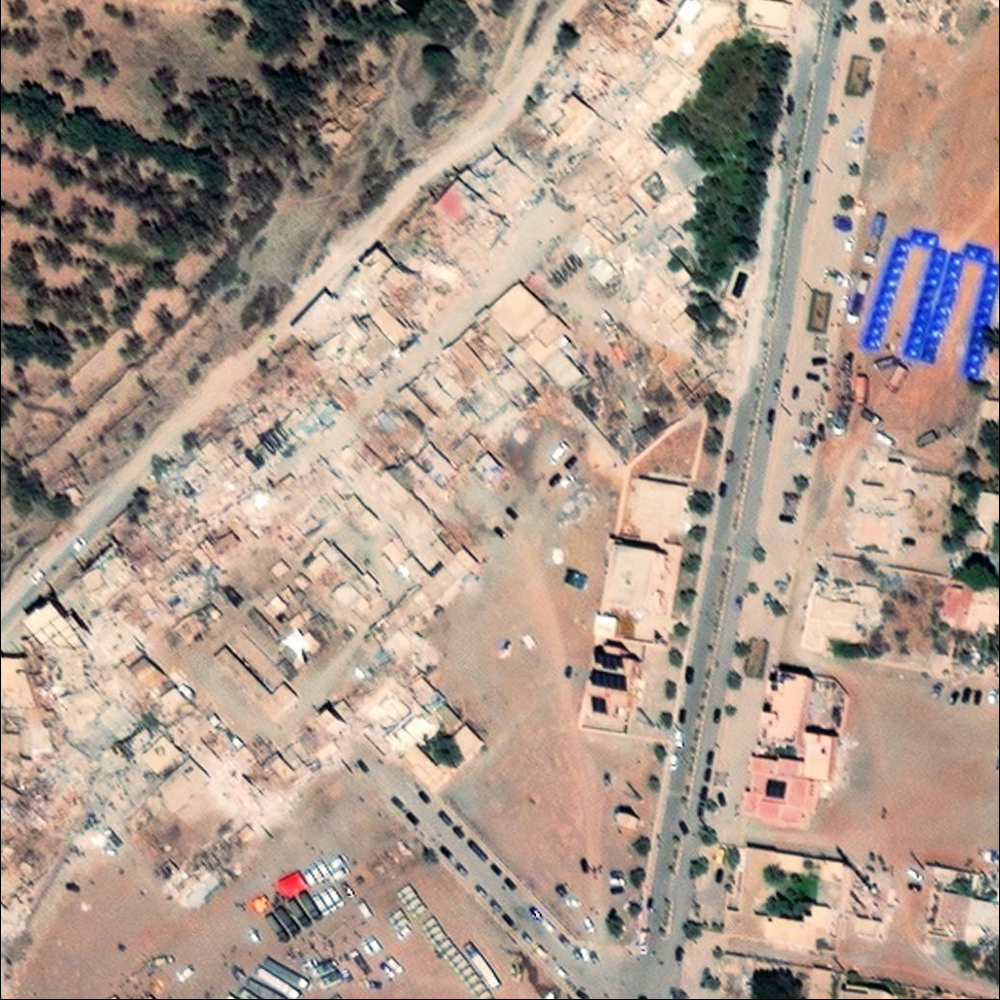
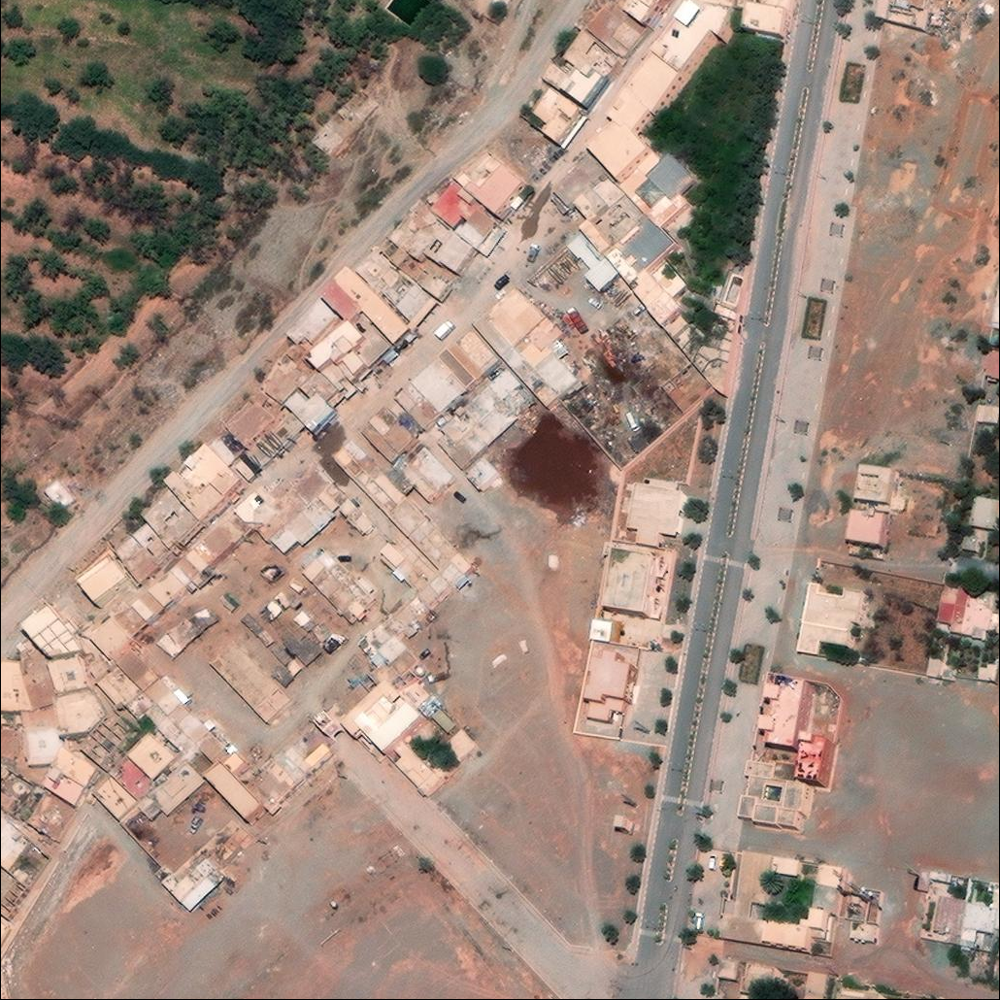

In [135]:
map_ = explore_dm(talat, 
           img_id=talat.img_id.unique()[0], 
           dataset=dataset, 
          urban_zs_label=None)
map_

In [304]:
# FresUNet
damage_map.explore("damage", cmap="RdBu_r")

In [215]:
# siam conc
damage_map.explore("damage", cmap="RdBu_r")

In [209]:
dataset.iloc[137]

before_path                    /home/rustt/Documents/Projects/building_damage...
after_path                     /home/rustt/Documents/Projects/building_damage...
town_name                                                                    100
geometry                            POINT (571724.6740240334 3408186.4768092777)
quadkey                                                             120202021330
before_href                    https://maxar-opendata.s3.amazonaws.com/events...
before_view_off_nadir                                                       26.4
before_view_azimuth                                                   136.800003
before_view_incidence_angle                                                 60.8
before_view_sun_azimuth                                                    106.2
before_view_sun_elevation                                                   70.2
before_platform                                                             WV03
before_clouds_percent       